In [4]:
import h5py
import trimesh
import os
import open3d as o3d
import copy
import json

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [5]:
def generate_pth_cls(id,part_id):
    mesh_base_dir = '/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{}/objs/new-{}.obj'.format(id,part_id)
    return mesh_base_dir

In [6]:
import os
import numpy as np
import trimesh

# Load JSON file
def load_json(file_path):
    with open(file_path, 'r') as file:
        data = json.load(file)
    return data


def generate_color_palette(num_colors):
    np.random.seed(42)
    return np.random.rand(num_colors, 3)  # Generate colors in range [0, 1]

def update_number_to_label(existing_dict, new_labels):
    start_index = len(existing_dict)
    for label in new_labels:
        if label not in existing_dict.values():
            existing_dict[start_index] = label
            start_index += 1
    return existing_dict


def extract_parts(data, parent_label=''):
    parts = []
    if isinstance(data, dict):
        if 'text' in data:
            label = parent_label + ' -> ' + data['text'] if parent_label else data['text']
            if 'objs' in data:
                parts.append((label, data['objs']))
            if 'children' in data:
                for child in data['children']:
                    parts.extend(extract_parts(child, label))
    elif isinstance(data, list):
        for item in data:
            parts.extend(extract_parts(item, parent_label))
    return parts


def load_and_color_meshes_instance(obj_id, parts, number_to_label=None):
    if number_to_label is None:
        number_to_label = {}

    obj_base_dir = f'/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{obj_id}/objs'
    combined_mesh = trimesh.Scene()
    combined_vertices = []
    combined_labels = []

    # Flatten the list of parts to get all unique labels and object IDs
    all_objects = [(label, obj) for label, objs in parts for obj in objs]
    unique_labels = {f"{label}_{obj}" for label, obj in all_objects}
    
    # Update the global number_to_label dictionary
    number_to_label = update_number_to_label(number_to_label, unique_labels)
    
    color_palette = generate_color_palette(len(number_to_label))
    label_to_color = {number_to_label[i]: (color_palette[i] * 255).astype(np.uint8) for i in number_to_label.keys()}

    for label, objs in parts:
        for obj in objs:
            identifier = f"{label}_{obj}"
            color = label_to_color[identifier]
            label_number = list(number_to_label.keys())[list(number_to_label.values()).index(identifier)]
            mesh_path = os.path.join(obj_base_dir, f"{obj}.obj")
            if os.path.exists(mesh_path):
                mesh = trimesh.load(mesh_path)
                vertices = mesh.vertices
                num_vertices = vertices.shape[0]
                labels = np.full((num_vertices, 1), label_number)

                combined_vertices.append(vertices)
                combined_labels.append(labels)

                # Assign a color to the mesh
                mesh.visual.vertex_colors = np.tile(color, (len(mesh.vertices), 1))
                # Add mesh to the scene
                combined_mesh.add_geometry(mesh)
            else:
                print(f"Mesh file {mesh_path} not found!")

    if combined_vertices:
        combined_vertices = np.vstack(combined_vertices)
        combined_labels = np.vstack(combined_labels)
        point_cloud = np.hstack((combined_vertices, combined_labels))
    else:
        point_cloud = np.array([])

    return point_cloud, number_to_label, combined_mesh

def update_number_to_label(existing_dict, new_labels):
    start_index = len(existing_dict)
    print(start_index)
    for label in new_labels:
        if label not in existing_dict.values():
            existing_dict[start_index] = label
            start_index += 1
    return existing_dict

def load_and_color_meshes_semantics(obj_id, parts, number_to_label=None):
    # if len(number_to_label)==0 :
    #     number_to_label = {}

    obj_base_dir = f'/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{obj_id}/objs'
    combined_mesh = trimesh.Scene()
    combined_vertices = []
    combined_labels = []

    # Get all unique labels
    unique_labels = {label for label, _ in parts}
    
    # Update the number_to_label dictionary
    number_to_label = update_number_to_label(number_to_label, unique_labels)
    
    color_palette = generate_color_palette(len(number_to_label))
    label_to_color = {label: color_palette[i] for i, label in enumerate(unique_labels)}

    label_counts = {label: 0 for label in unique_labels}

    for label, objs in parts:
        label_number = list(number_to_label.keys())[list(number_to_label.values()).index(label)]
        color = label_to_color[label]
        # label = label.split('->')[-1]
        for obj in objs:
            mesh_path = os.path.join(obj_base_dir, f"{obj}.obj")
            if os.path.exists(mesh_path):
                mesh = trimesh.load(mesh_path)
                vertices = mesh.vertices
                num_vertices = vertices.shape[0]
                labels = np.full((num_vertices, 1), label_number)

                combined_vertices.append(vertices)
                combined_labels.append(labels)
                
                # Assign the color to the mesh
                mesh.visual.vertex_colors = np.tile(color, (mesh.vertices.shape[0], 1))
                
                # Create a unique node name
                unique_node_name = f"{label}_{label_counts[label]}"
                label_counts[label] += 1
                
                mesh.__name__ = unique_node_name.split('->')[0]+'_'+unique_node_name.split('->')[-1]
                # print(mesh.__name__)

                # Add mesh to the scene
                combined_mesh.add_geometry(mesh,node_name=unique_node_name.split('->')[-1],geom_name=unique_node_name.split('->')[-1])
            else:
                print(f"Mesh file {mesh_path} not found!")

    if combined_vertices:
        combined_vertices = np.vstack(combined_vertices)
        combined_labels = np.vstack(combined_labels)
        point_cloud = np.hstack((combined_vertices, combined_labels))
    else:
        point_cloud = np.array([])

    return point_cloud, number_to_label, combined_mesh


obj_id1 = '12159'

obj_base_dir = '/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{}'.format(obj_id1)
obj_structure_1 = load_json(os.path.join(obj_base_dir,'result.json'))
# Extract parts with labels and object files
parts1 = extract_parts(obj_structure_1)

label_to_number = {}
# Load first object
point_cloud1, label_to_number, combined_mesh1 = load_and_color_meshes_semantics(obj_id1, parts1,label_to_number)



# # Save combined meshes if needed
# combined_mesh1.export(f'/path/to/save/{obj_id1}_combined_mesh.obj')
# combined_mesh2.export(f'/path/to/save/{obj_id2}_combined_mesh.obj')


0


In [7]:
mx = create_rotation_matrix('x',100)
combined_mesh1.apply_transform(mx)

<trimesh.Scene(len(geometry)=13)>

In [8]:
combined_mesh1.show()

In [9]:
id_list = ['37965','10033','43634','15052','10222','27996','12100']
point_clouds = {}
mesh_dict = {}
label_to_number = {}

for obj_id in id_list:
    obj_base_dir = '/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{}'.format(obj_id)
    obj_structure = load_json(os.path.join(obj_base_dir,'result.json'))

    # Extract parts with labels and object files
    parts = extract_parts(obj_structure)

    # Load first object
    point_cloud, label_to_number, combined_mesh = load_and_color_meshes_semantics(obj_id, parts,label_to_number)

    mesh_dict[obj_id] = combined_mesh
    point_clouds[obj_id] = point_cloud
    # point_cloud_list.append(point_cloud)



0
12
22
25
31
38
42


# Generate scene

#scale
#rotate
#align to ground
#translation
#concatenate

In [10]:
import numpy as np
import random
import trimesh

# Function definitions

def scale_point_cloud(point_cloud, min_val, max_val):
    extents = np.max(point_cloud[:, :3], axis=0) - np.min(point_cloud[:, :3], axis=0)
    scale_factor = (max_val - min_val) / np.max(extents)
    point_cloud[:, :3] *= scale_factor
    return point_cloud

def align_point_cloud_to_ground(point_cloud):
    min_z = np.min(point_cloud[:, 2])
    point_cloud[:, 2] -= min_z
    return point_cloud

def rotate_point_cloud_x_90(point_cloud):
    rotation_matrix = trimesh.transformations.rotation_matrix(np.radians(90), [1, 0, 0])[:3, :3]
    point_cloud[:, :3] = np.dot(point_cloud[:, :3], rotation_matrix.T)
    return point_cloud

def rotate_point_cloud_z(point_cloud, angle_degrees):
    rotation_matrix = trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [0, 0, 1])[:3, :3]
    point_cloud[:, :3] = np.dot(point_cloud[:, :3], rotation_matrix.T)
    return point_cloud

def translate_point_cloud(point_cloud, translation):
    point_cloud[:, :3] += translation
    return point_cloud

def rotate_point_cloud_around_center(point_cloud, angle_degrees):
    center = np.mean(point_cloud[:, :3], axis=0)
    point_cloud[:, :3] -= center
    point_cloud = rotate_point_cloud_z(point_cloud, angle_degrees)
    point_cloud[:, :3] += center
    return point_cloud

# # Dictionary of point clouds
# point_clouds = {
#     '10033': np.random.rand(100, 4),  # Example point cloud data
#     '43634': np.random.rand(100, 4),
#     '27996': np.random.rand(100, 4),
#     '12100': np.random.rand(100, 4),
#     '15052': np.random.rand(100, 4),
#     '10222': np.random.rand(100, 4),
# }

# Define the scale ranges for each object
scale_ranges = {
    '10033': (-3, 3),
    '43634': (-1.5, 1.5),
    '27996': (-2, 2),
    '12100': (-0.5, 0.5),
    '15052': (-1, 1),
    '10222': (-0.5, 0.5),
}

# Process each point cloud
for obj_id, point_cloud in point_clouds.items():
    scale_range = scale_ranges[obj_id]
    point_cloud = rotate_point_cloud_x_90(point_cloud)
    point_cloud = scale_point_cloud(point_cloud, scale_range[0], scale_range[1])
    point_cloud = align_point_cloud_to_ground(point_cloud)
    
    point_clouds[obj_id] = point_cloud

# Extract individual point clouds for easier manipulation
bed_pc = point_clouds['10033']
chair_pc = point_clouds['43634']
table_pc = point_clouds['27996']
trashcan_pc = point_clouds['12100']
laptop_pc = point_clouds['10222']
lamp_pc = point_clouds['15052']

# counter_pc = point_clouds['']

# Define positions based on the described layout
table_position = [0, 0, 0]
chair_position = [-0.5, -1.5, 0]
trashcan_position = [1, -1, 0]
bed_position = [4, 0, 0]

# Calculate the height of the table to place objects on top of it
table_height = np.max(table_pc[:, 2])

# Position for laptop and lamp on the table
laptop_position = [0.5, 0, table_height]
lamp_position = [-1, 0, table_height]

# Apply translations to place each point cloud in the correct position
table_pc = translate_point_cloud(table_pc, table_position)
chair_pc = translate_point_cloud(chair_pc, chair_position)
chair_pc = rotate_point_cloud_around_center(chair_pc, 180)
trashcan_pc = translate_point_cloud(trashcan_pc, trashcan_position)
bed_pc = translate_point_cloud(bed_pc, bed_position)
laptop_pc = translate_point_cloud(laptop_pc, laptop_position)
lamp_pc = translate_point_cloud(lamp_pc, lamp_position)

# Combine all point clouds into one array
combined_point_cloud = np.vstack([bed_pc, chair_pc, table_pc, trashcan_pc, laptop_pc, lamp_pc])

# Save the combined point cloud to a file
np.savetxt('combined_point_cloud.txt', combined_point_cloud)

# Optionally visualize the combined point cloud using matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(combined_point_cloud[:, 0], combined_point_cloud[:, 1], combined_point_cloud[:, 2], c=combined_point_cloud[:, 3])
plt.show()


KeyError: '37965'

# Find each node geometry (part) of each objects

In [152]:
id_list = ['37965', '10033','43634','15052','10222','27996','12100','4047']



def generate_scene_objects(id_list): 
    point_clouds = {}
    mesh_dict = {}
    label_to_number = {}
    central_points_dict = {}

    for obj_id in id_list:
        obj_base_dir = '/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{}'.format(obj_id)
        obj_structure = load_json(os.path.join(obj_base_dir,'result.json'))

        # Extract parts with labels and object files
        parts = extract_parts(obj_structure)

        # Load first object
        point_cloud, label_to_number, combined_mesh = load_and_color_meshes_semantics(obj_id, parts,label_to_number)

        mesh_dict[obj_id] = combined_mesh
        point_clouds[obj_id] = point_cloud
        # point_cloud_list.append(point_cloud)|
    return point_clouds, mesh_dict, label_to_number




In [1]:
import trimesh
import numpy as np

def create_scale_matrix(scale_factor):
    scale_matrix = np.eye(4)
    scale_matrix[:3, :3] *= scale_factor
    return scale_matrix

def create_rotation_matrix(axis, angle_degrees):
    if axis == 'x':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [1, 0, 0])
    elif axis == 'y':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [0, 1, 0])
    elif axis == 'z':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [0, 0, 1])

def create_translation_matrix(translation):
    translation_matrix = np.eye(4)
    translation_matrix[:3, 3] = translation
    return translation_matrix



# Define the scale factors for each object
scale_factors = {
    '10033': 3,    # Bed
    '43634': 1.5,  # Chair
    '27996': 2,    # Table
    '12100': 0.5,  # Trashcan
    '15052': 0.5,  # Lamp
    '10222': 0.5,  # Laptop
    '37965': 3,    # Counter
    '4047': 0.5    # Vase
}

# Example mesh_dict (you need to load your actual mesh scenes here)
point_clouds, mesh_dict, label_to_number = generate_scene_objects(list(scale_factors.keys()))

# Rotate and align all objects
aligned_mesh_dict = {}
for obj_id, mesh in mesh_dict.items():
    rotation_matrix_x = create_rotation_matrix('x', 90)
    mesh.apply_transform(rotation_matrix_x)
    # Align to ground after rotation
    translation_to_ground = create_translation_matrix([0, 0, -mesh.bounds[0][2]])
    mesh.apply_transform(translation_to_ground)
    scale_factor = scale_factors[obj_id]
    scale_matrix = create_scale_matrix(scale_factor)
    mesh.apply_transform(scale_matrix)
    
    aligned_mesh_dict[obj_id] = mesh

# Define positions based on the described layout
table_position = [2, 0, 0]
chair_position = [1.5, -2, 0]  # Chair close to table, head to table
trashcan_position = [3, -1, 0]  # Trash bin close to table
bed_position = [6, 0, 0]  # Bed on the right side of the table, chair, and trashcan
counter_position = [-3, -3, 0]

# Calculate the height of the table to place objects on top of it
table_mesh = aligned_mesh_dict['27996']
table_height = table_mesh.bounds[1][2]

# Calculate the height of the counter to place objects on top of it
counter_mesh = aligned_mesh_dict['37965']
counter_height = counter_mesh.bounds[1][2]

# Adjust the positions for laptop, lamp, and vase to be placed on top of the table and counter
laptop_position = [2.5, 0, table_height]
lamp_position = [1, 0, table_height]
vase_position = [-3, -3, counter_height]  # Placing vase on the counter

# Debug: Print the calculated height of the table and counter
print(f"Calculated table height: {table_height}")
print(f"Calculated counter height: {counter_height}")

# Debug: Print the positions of the laptop, lamp, and vase
print(f"Laptop position: {laptop_position}")
print(f"Lamp position: {lamp_position}")
print(f"Vase position: {vase_position}")

# Combine all the scene objects into a single scene
combined_scene = trimesh.Scene()
central_points_dict ={}
# Add geometries from each scene to the combined scene and apply scaling and final positioning
for obj_id, mesh in aligned_mesh_dict.items():
    scale_factor = scale_factors[obj_id]
    scale_matrix = create_scale_matrix(scale_factor)
    
    # Define final positions for each object
    if obj_id == '10033':  # Bed
        final_position = bed_position
    elif obj_id == '43634':  # Chair
        final_position = chair_position
    elif obj_id == '27996':  # Table
        final_position = table_position
    elif obj_id == '12100':  # Trashcan
        final_position = trashcan_position
    elif obj_id == '15052':  # Lamp
        final_position = lamp_position
    elif obj_id == '10222':  # Laptop
        final_position = laptop_position
    elif obj_id == '37965':  # Counter
        final_position = counter_position
    elif obj_id == '4057':  # Vase
        final_position = vase_position
    
    final_translation_matrix = create_translation_matrix(final_position)
    
    for node_name in mesh.graph.nodes_geometry:
        transform, geometry_name = mesh.graph[node_name]
        geometry = mesh.geometry[geometry_name]
        
        # Combine the existing transformation with the final positioning and scaling
        final_transform = transform

        # Apply additional rotation for the chair to fix its orientation around its central axis
        if obj_id == '43634':
            chair_rotation_180 = create_rotation_matrix('z', 180)
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(chair_rotation_180, np.dot(center_translation_to_origin, final_transform)))
        
        if obj_id == '37965':
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(create_rotation_matrix('z', 90), np.dot(center_translation_to_origin, final_transform)))
        
        final_transform = np.dot(final_translation_matrix, final_transform)
        
        combined_scene.add_geometry(geometry, transform=final_transform)
        transformed_central_point = np.dot(final_transform, np.append(geometry.centroid, 1))[:3]
        central_points_dict[geometry.__name__] = transformed_central_point

# Optionally, display the combined scene
combined_scene.show()


NameError: name 'generate_scene_objects' is not defined

In [12]:
import trimesh
import numpy as np

def create_scale_matrix(scale_factor):
    scale_matrix = np.eye(4)
    scale_matrix[:3, :3] *= scale_factor
    return scale_matrix

def create_rotation_matrix(axis, angle_degrees):
    if axis == 'x':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [1, 0, 0])
    elif axis == 'y':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [0, 1, 0])
    elif axis == 'z':
        return trimesh.transformations.rotation_matrix(np.radians(angle_degrees), [0, 0, 1])

def create_translation_matrix(translation):
    translation_matrix = np.eye(4)
    translation_matrix[:3, 3] = translation
    return translation_matrix

def generate_scene_objects(id_list):
    point_clouds = {}
    mesh_dict = {}
    label_to_number = {}
    central_points_dict = {}

    for obj_id in id_list:
        obj_base_dir = f'/home/lidosan/Datasets/datasets--ShapeNet--PartNet-archive/blobs/data_v0/{obj_id}'
        obj_structure = load_json(os.path.join(obj_base_dir, 'result.json'))

        # Extract parts with labels and object files
        parts = extract_parts(obj_structure)

        # Load first object
        point_cloud, label_to_number, combined_mesh = load_and_color_meshes_semantics(obj_id, parts, label_to_number)

        mesh_dict[obj_id] = combined_mesh
        point_clouds[obj_id] = point_cloud

    return point_clouds, mesh_dict, label_to_number

def basic_transformation(mesh,obj_id):
    rotation_matrix_x = create_rotation_matrix('x', 90)
    mesh.apply_transform(rotation_matrix_x)
    # Align to ground after rotation
    translation_to_ground = create_translation_matrix([0, 0, -mesh.bounds[0][2]])
    mesh.apply_transform(translation_to_ground)
    scale_factor = scale_factors[obj_id]
    scale_matrix = create_scale_matrix(scale_factor)
    mesh.apply_transform(scale_matrix)
    return mesh

# Define the scale factors for each object
scale_factors = {
    '10033': 3,    # Bed
    '43634': 1.5,  # Chair
    '27996': 2,    # Table
    '12100': 0.5,  # Trashcan
    '15052': 0.5,  # Lamp
    '10222': 0.5,  # Laptop
    '37965': 3,    # Counter
    '4057': 0.5,   # Vase
    '9994': 2,     # Refrigerator
    '3465': 1,     # Microwave
    '2581': 2,     # Arm Chair_2

}

# Example mesh_dict (you need to load your actual mesh scenes here)
point_clouds, mesh_dict, label_to_number = generate_scene_objects(list(scale_factors.keys()))

# Rotate and align all objects
aligned_mesh_dict = {}
for obj_id, mesh in mesh_dict.items():
    aligned_mesh_dict[obj_id] = basic_transformation(mesh,obj_id)

# Define positions based on the described layout
table_position = [2, 0, 0]
chair_position = [2, -2, 0]  # Chair close to table, head to table
trashcan_position = [3, -1, 0]  # Trash bin close to table
bed_position = [6, 0, 0]  # Bed on the right side of the table, chair, and trashcan
counter_position = [-3, -3, 0]
refrigerator_position = [-3, -7, 0]  # Refrigerator next to the counter

# Calculate the height of the table to place objects on top of it
table_mesh = aligned_mesh_dict['27996']
table_height = table_mesh.bounds[1][2]

# Calculate the height of the counter to place objects on top of it
# The counter top should be redefiend
counter_mesh = aligned_mesh_dict['37965']
counter_top = copy.deepcopy(counter_mesh.geometry[' Countertop_0'])
counter_top = basic_transformation(counter_top,'37965')
counter_height =  counter_top.bounds[1][2]

# Adjust the positions for laptop, lamp, and vase to be placed on top of the table and counter
laptop_position = [2.5, 0, table_height]
lamp_position = [1, 0, table_height]
vase_position = [-3, -3, counter_height]  # Placing vase on the counter
microwave_position = [-3,-1, counter_height]


arm_chair_position_1=[1.5,-7,0]
arm_chair_position_2=[0,-5,0]


# Debug: Print the calculated height of the table and counter
print(f"Calculated table height: {table_height}")
print(f"Calculated counter height: {counter_height}")

# Debug: Print the positions of the laptop, lamp, and vase
print(f"Laptop position: {laptop_position}")
print(f"Lamp position: {lamp_position}")
print(f"Vase position: {vase_position}")
print(f"Refrigerator position: {refrigerator_position}")

# Combine all the scene objects into a single scene
combined_scene = trimesh.Scene()
central_points_dict = {}
# Add geometries from each scene to the combined scene and apply scaling and final positioning
for obj_id, mesh in aligned_mesh_dict.items():
    scale_factor = scale_factors[obj_id]
    scale_matrix = create_scale_matrix(scale_factor)
    # Define final positions for each object
    if obj_id == '10033':  # Bed
        final_position = bed_position
    elif obj_id == '43634':  # Chair
        final_position = chair_position
    elif obj_id == '27996':  # Table
        final_position = table_position
    elif obj_id == '12100':  # Trashcan
        final_position = trashcan_position
    elif obj_id == '15052':  # Lamp
        final_position = lamp_position
    elif obj_id == '10222':  # Laptop
        final_position = laptop_position
    elif obj_id == '37965':  # Counter
        final_position = counter_position
    elif obj_id == '4057':  # Vase
        final_position = vase_position
    elif obj_id == '9994':  # Refrigerator
        final_position = refrigerator_position
    elif obj_id == '3465':  # Refrigerator
        final_position = microwave_position
    elif obj_id =='2581': #arm_chair
        final_position = arm_chair_position_1
        
    final_translation_matrix = create_translation_matrix(final_position)
    
    for node_name in mesh.graph.nodes_geometry:
        transform, geometry_name = mesh.graph[node_name]
        geometry = mesh.geometry[geometry_name]
        
        # Combine the existing transformation with the final positioning and scaling
        final_transform = transform

        # Apply additional rotation for the chair to fix its orientation around its central axis
        if obj_id == '43634':
            # rotate the chair
            chair_rotation_180 = create_rotation_matrix('z', 101)
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(chair_rotation_180, np.dot(center_translation_to_origin, final_transform)))
        
        if obj_id == '37965':
            #rotate the counter
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(create_rotation_matrix('z', 90), np.dot(center_translation_to_origin, final_transform)))
        
        if obj_id == '9994':
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(create_rotation_matrix('z', 90), np.dot(center_translation_to_origin, final_transform)))
        
        if obj_id == '3465':
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(create_rotation_matrix('z', 90), np.dot(center_translation_to_origin, final_transform)))
        
        if obj_id == '2581':
            center_translation_to_origin = create_translation_matrix(-mesh.centroid)
            center_translation_back = create_translation_matrix(mesh.centroid)
            final_transform = np.dot(center_translation_back, np.dot(create_rotation_matrix('z', 180), np.dot(center_translation_to_origin, final_transform)))
        
            
            
            
        
        final_transform = np.dot(final_translation_matrix, final_transform)
        
        combined_scene.add_geometry(geometry, transform=final_transform)
        transformed_central_point = np.dot(final_transform, np.append(geometry.centroid, 1))[:3]
        central_points_dict[geometry.__name__] = transformed_central_point

# Optionally, display the combined scene
combined_scene.show()


0
10
13
17
20
26
33
45
48
52
60
Calculated table height: 1.6253579999999999
Calculated counter height: 2.0507940000000002
Laptop position: [2.5, 0, 1.6253579999999999]
Lamp position: [1, 0, 1.6253579999999999]
Vase position: [-3, -3, 2.0507940000000002]
Refrigerator position: [-3, -7, 0]


In [284]:
def look_at(source_centroid, target_centroid):
    forward = target_centroid - source_centroid
    forward = forward / np.linalg.norm(forward)  # Normalize the forward vector

    up = np.array([0, 0, 1])  # Assuming z-up coordinate system
    right = np.cross(up, forward)
    right = right / np.linalg.norm(right)

    up = np.cross(forward, right)
    
    rotation_matrix = np.eye(4)
    rotation_matrix[:3, 0] = right
    rotation_matrix[:3, 1] = up
    rotation_matrix[:3, 2] = forward
    
    return rotation_matrix

def get_closest_face_center(target_mesh, source_center):
    bounds = target_mesh.bounds
    face_centers = [
        [(bounds[0][0] + bounds[1][0]) / 2, bounds[0][1], (bounds[0][2] + bounds[1][2]) / 2],  # Front face
        [(bounds[0][0] + bounds[1][0]) / 2, bounds[1][1], (bounds[0][2] + bounds[1][2]) / 2],  # Back face
        [bounds[0][0], (bounds[0][1] + bounds[1][1]) / 2, (bounds[0][2] + bounds[1][2]) / 2],  # Left face
        [bounds[1][0], (bounds[0][1] + bounds[1][1]) / 2, (bounds[0][2] + bounds[1][2]) / 2],  # Right face
    ]
    face_centers = np.array(face_centers)
    distances = np.linalg.norm(face_centers - source_center, axis=1)
    closest_face_center = face_centers[np.argmin(distances)]
    return closest_face_center


In [280]:
# Example usage
source_id = '43634'  # Chair
target_id = '27996'  # Table

source_mesh = aligned_mesh_dict[source_id]
target_mesh = aligned_mesh_dict[target_id]

def get_bounding_box_center(mesh):
    return (mesh.bounds[0] + mesh.bounds[1]) / 2


source_point = get_bounding_box_center(source_mesh)
target_point = get_bounding_box_center(target_mesh)

source_centroid = source_mesh.centroid
target_centroid = target_mesh.centroid

def calculate_rotation_angle(source_centroid, target_centroid):
    direction = target_centroid - source_centroid
    angle = np.arctan2(direction[1], direction[0])
    angle_degrees = np.degrees(angle)
    return angle_degrees


# Calculate look at matrix
look_at_matrix = calculate_rotation_angle(source_point, target_point)
target_center = get_closest_face_center(target_mesh,source_point)
angle_degrees = calculate_rotation_angle(source_point, target_center)
look_at_matrix

101.04383927347558

In [287]:
combined_scene.export('scene_test.obj')
final_mesh = trimesh.load('scene_test.obj')

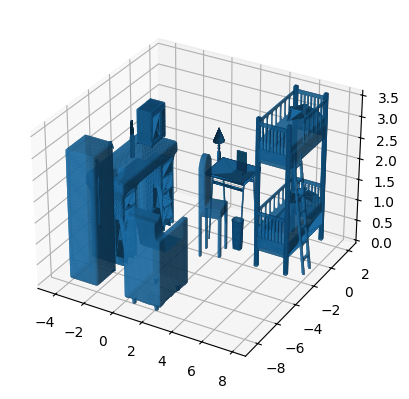

In [288]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_trisurf(final_mesh.vertices[:, 0], final_mesh.vertices[:,1], triangles=final_mesh.faces, Z=final_mesh.vertices[:,2]) 

plt.show()

# Visualization

In [291]:
import pyviz3d.visualizer as viz
import numpy as np
import open3d as o3d

# Assuming central_points_dict is already defined
# Example: central_points_dict = {'mesh1': np.array([1.0, 0.0, 0.0]), 'mesh2': np.array([0.0, 1.0, 0.0]), ...}

def generate_pth_scene(category, id):
    scene = 'scene1'
    obj_dir = f"{scene}/{category}_{id}.obj"
    return obj_dir

def main():
    v = viz.Visualizer(position=[5, 5, 1])

    # Adding a mesh (example: Bed)
    v.add_mesh('Scene',
        path='scene_test.obj',
        color=np.array([255, 255, 255]),
    )


    # v.add_labels('Axis',
    #              ['text_x', 'texty_y', 'text_z'],
    #              [np.array([1.0, 0.0, 0.0]), np.array([0.0, 1.0, 0.0]), np.array([0.0, 0.0, 1.0])],
    #              [np.array([255.0, 0.0, 0.0]), np.array([0.0, 255.0, 0.0]), np.array([0.0, 0.0, 255.0])],
    #              visible=False)
    
    # Prepare labels and their locations from the central_points_dict
    labels = list(central_points_dict.keys())
    locations = list(central_points_dict.values())
    colors = [np.random.rand(3) * 255 for _ in labels]

    # Add labels to the visualizer
    # v.add_labels('Labels',
    #              labels,
    #              locations,
    #              colors,
    #              visible=False)

    v.save('example_meshes')

if __name__ == '__main__':
    main()



************************************************************************
1) Start local server:
    cd /home/lidosan/Workplace-why/PartSecne/example_meshes; python -m http.server 6008
2) Open in browser:
    http://localhost:6008
************************************************************************
